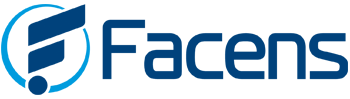
# TCC - Ciências de Dados - Turma 2020/1
## Sales Forecast

*   Louise Constantino - 203071
*   Luiza Constantino  - 203087

# Bibliotecas

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pylab import rcParams
import psycopg2
import itertools
from itertools import product
from tqdm import tqdm_notebook
from math import sqrt
import seaborn as sns
import statsmodels.api as sm
import statsmodels.tsa.api as smt

#!pip install sktime

import warnings
warnings.filterwarnings("ignore")
plt.style.use('fivethirtyeight')

from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn import preprocessing
from sklearn.preprocessing import MinMaxScaler
from xgboost import plot_importance, plot_tree
from sklearn.metrics import r2_score
from sklearn.model_selection import GridSearchCV
import xgboost as xgb
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import time
import re
from sklearn.datasets import load_boston
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score, KFold

from fbprophet import Prophet
from fbprophet.plot import plot_cross_validation_metric
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from fbprophet.plot import add_changepoints_to_plot

# Interactive methods
from fbprophet.plot import plot_plotly, plot_components_plotly 
import plotly.offline as py
import plotly.io as pio
pio.renderers.default = "colab"

%pip install neuralprophet
from neuralprophet import NeuralProphet

sns.set_style('whitegrid')
plt.style.use('fivethirtyeight')
plt.rcParams['figure.figsize']=(20,10) # for graphs styling
plt.style.use('tableau-colorblind10') # for graph stying

/usr/local/lib/python3.7/dist-packages/psycopg2/__init__.py:144: UserWarning: The psycopg2 wheel package will be renamed from release 2.8; in order to keep installing from binary please use "pip install psycopg2-binary" instead. For details see: <http://initd.org/psycopg/docs/install.html#binary-install-from-pypi>.
  """)
/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


# Carrega DataSet

In [2]:
df = pd.read_csv('ds_bebidas.csv')
df.head()

,dt_referencia,nr_referencia,ds_regiao_atendimento,ds_area,ds_canal,ds_visao_empesa,fg_feriado,ds_categoria,vl_caixa_fisica
0,2018-01-20T00:00:00.0000000,2018-01-01T00:00:00.0000000,FORA REGIAO,Funcionário,FUNCIONARIOS,FUNCIONARIO,0,CARBONATADOS,1.0
1,2018-03-26T00:00:00.0000000,2018-03-01T00:00:00.0000000,FORA REGIAO,Mercado Interno,LANCHONETE,MERCADO FRIO,0,AGUA,3.0
2,2018-03-07T00:00:00.0000000,2018-03-01T00:00:00.0000000,FORA REGIAO,Mercado Externo,OUTRAS FRANQUIAS %,OUTRAS FRANQUIAS - 7,0,NAO CARBONATADOS,2464.0
3,2018-05-11T00:00:00.0000000,2018-05-01T00:00:00.0000000,FORA REGIAO,Mercado Externo,OUTRAS FRANQUIAS 12%,OUTRAS FRANQUIAS 12,0,NAO CARBONATADOS,16272.0
4,2018-02-24T00:00:00.0000000,2018-02-01T00:00:00.0000000,FORA REGIAO,Mercado Externo,OUTRAS FRANQUIAS 12%,OUTRAS FRANQUIAS 12,0,NAO CARBONATADOS,16992.0


# Tratamento dos Dados e Análise Exploratória

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 546395 entries, 0 to 546394
Data columns (total 9 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   dt_referencia          546395 non-null  object 
 1   nr_referencia          546395 non-null  object 
 2   ds_regiao_atendimento  546395 non-null  object 
 3   ds_area                546395 non-null  object 
 4   ds_canal               546395 non-null  object 
 5   ds_visao_empesa        546395 non-null  object 
 6   fg_feriado             546395 non-null  int64  
 7   ds_categoria           546395 non-null  object 
 8   vl_caixa_fisica        546395 non-null  float64
dtypes: float64(1), int64(1), object(7)
memory usage: 37.5+ MB


## Conversão tipo de Dados

In [4]:
df.dt_referencia = pd.to_datetime(df['dt_referencia'])
df.fg_feriado = df.fg_feriado.astype('bool')

Checa resultado após conversão

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 546395 entries, 0 to 546394
Data columns (total 9 columns):
 #   Column                 Non-Null Count   Dtype         
---  ------                 --------------   -----         
 0   dt_referencia          546395 non-null  datetime64[ns]
 1   nr_referencia          546395 non-null  object        
 2   ds_regiao_atendimento  546395 non-null  object        
 3   ds_area                546395 non-null  object        
 4   ds_canal               546395 non-null  object        
 5   ds_visao_empesa        546395 non-null  object        
 6   fg_feriado             546395 non-null  bool          
 7   ds_categoria           546395 non-null  object        
 8   vl_caixa_fisica        546395 non-null  float64       
dtypes: bool(1), datetime64[ns](1), float64(1), object(6)
memory usage: 33.9+ MB


In [6]:
df[['vl_caixa_fisica']].describe()

,vl_caixa_fisica
count,546395.000000
mean,222.694283
std,994.121432
min,1.000000
25%,9.000000
50%,30.000000
75%,123.000000
max,130512.000000


## Dados Faltantes

In [7]:
df.isnull().sum()

dt_referencia            0
nr_referencia            0
ds_regiao_atendimento    0
ds_area                  0
ds_canal                 0
ds_visao_empesa          0
fg_feriado               0
ds_categoria             0
vl_caixa_fisica          0
dtype: int64

Não há dados faltantes.

## Distribuição do Volume

Verificando categorias com maior quantidade de registros

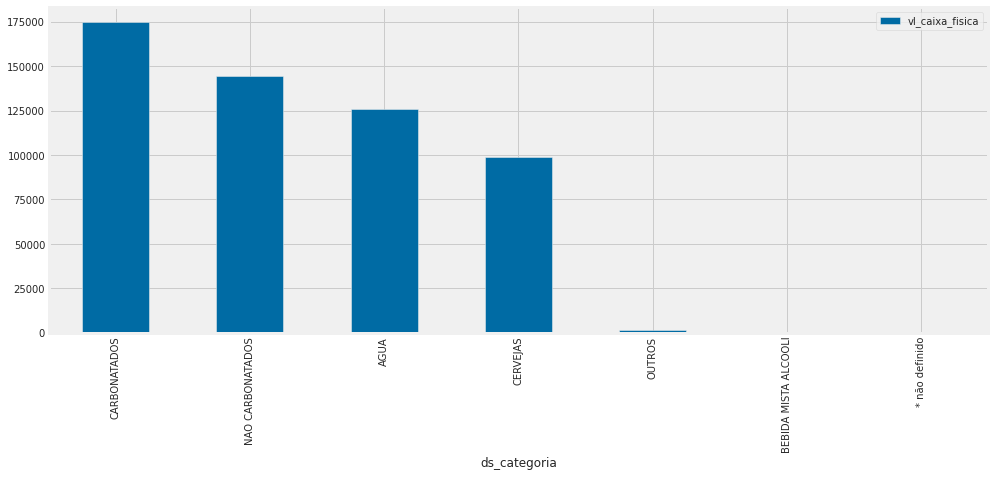

In [8]:
  df.groupby('ds_categoria').vl_caixa_fisica.count().to_frame().sort_values('vl_caixa_fisica', ascending=False).plot(kind='bar')
  plt.gcf().set_size_inches(15, 6)
  plt.show()

Distribuição total de registros por Categoria de Produto - Vamos considerar as 3 categorias com maior representação na base de dados:
- CARBONATADOS
- NÃO CARBONATADOS
- AGUA

In [9]:
df = df[df.ds_categoria.isin(['CARBONATADOS', 'NAO CARBONATADOS', 'AGUA'])]

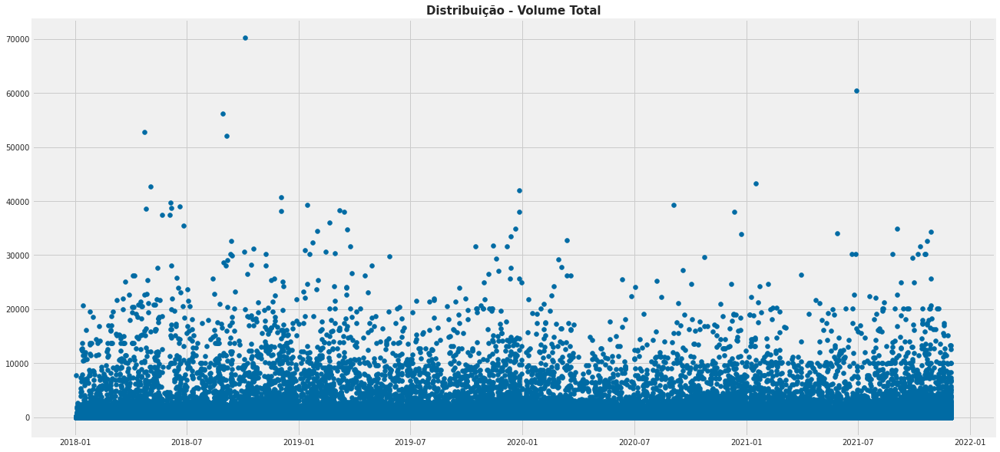

In [10]:
plt.figure(figsize=(20,10))
plt.title('Distribuição - Volume Total', size=15, fontweight='bold')
plt.scatter(df['dt_referencia'], df['vl_caixa_fisica'])
plt.show()

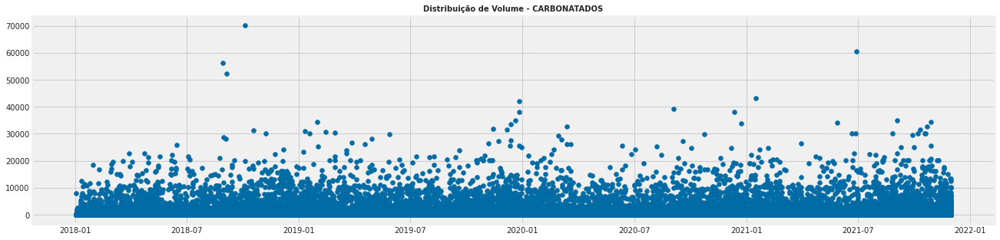

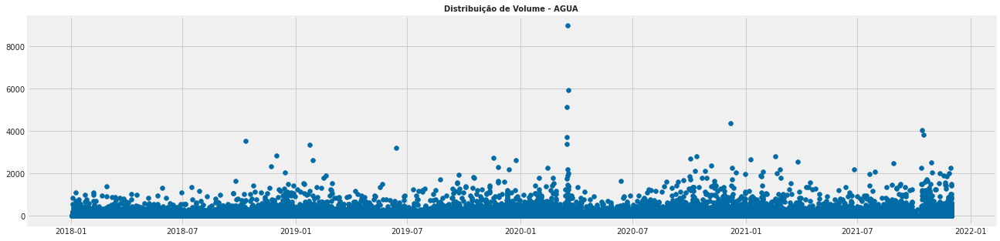

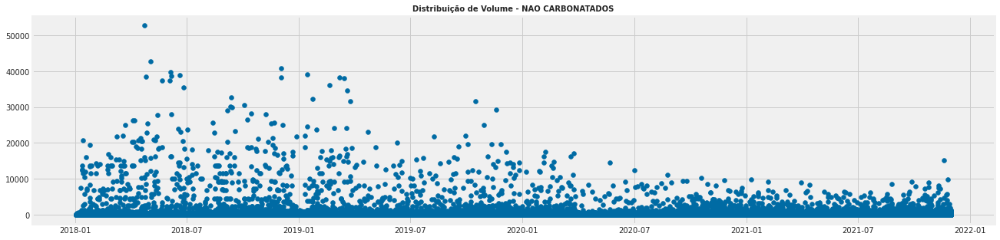

In [11]:
df_categoria = df.ds_categoria.unique()

for categoria in df_categoria:
  plt.figure(figsize=(20,5))
  data = df[df.ds_categoria == categoria]
  plt.title('Distribuição de Volume - {}'.format(categoria), size=10, fontweight='bold')
  plt.scatter(data.dt_referencia, data.vl_caixa_fisica)
  plt.show()

Nota-se outliers em todas as culturas e no total, portanto iremos removê-los para não impactar no treino do modelo.

Como são diferentes em cada categoria, vamos remover de forma diferente em cada uma delas

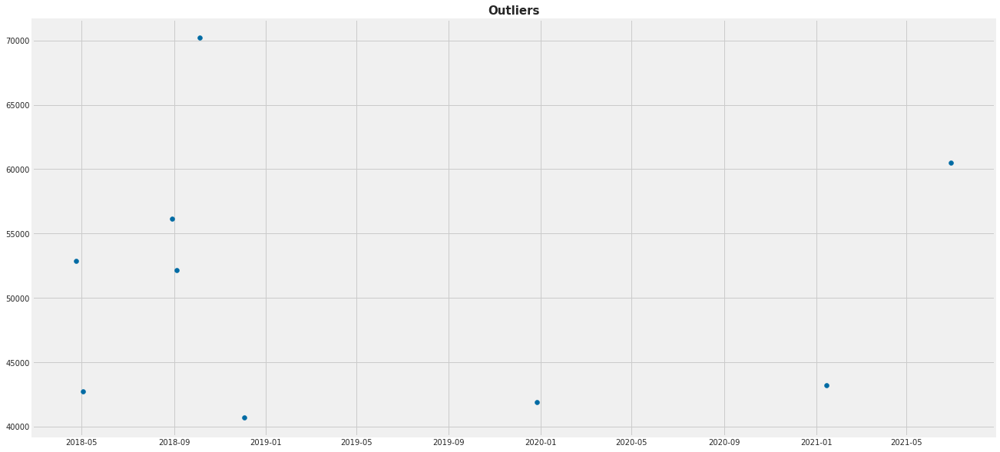

In [12]:
df_filter = df.where(df.vl_caixa_fisica > 40000)

plt.figure(figsize=(20,10))
plt.title('Outliers', size=15, fontweight='bold')
plt.scatter(df_filter['dt_referencia'], df_filter['vl_caixa_fisica'])
plt.show()

In [13]:
df = df[((df.vl_caixa_fisica <= 35000) & (df.ds_categoria == 'CARBONATADOS')) | (df.ds_categoria != 'CARBONATADOS') ] 
df = df[(df.vl_caixa_fisica <= 30000) & (df.ds_categoria == 'NAO CARBONATADOS') | (df.ds_categoria != 'NAO CARBONATADOS')] 
df = df[(df.vl_caixa_fisica <= 2500)  & (df.ds_categoria == 'AGUA') | (df.ds_categoria != 'AGUA')] 

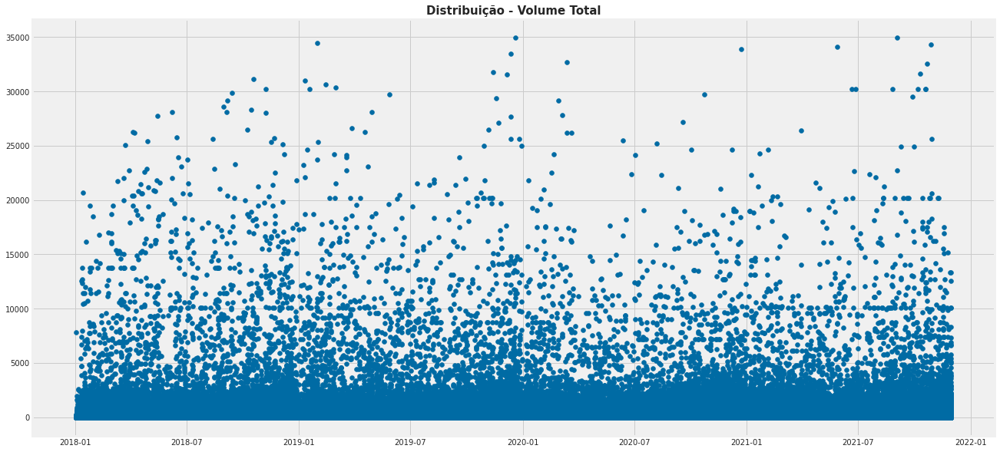

In [14]:
plt.figure(figsize=(20,10))
plt.title('Distribuição - Volume Total', size=15, fontweight='bold')
plt.scatter(df['dt_referencia'], df['vl_caixa_fisica'])
plt.show()

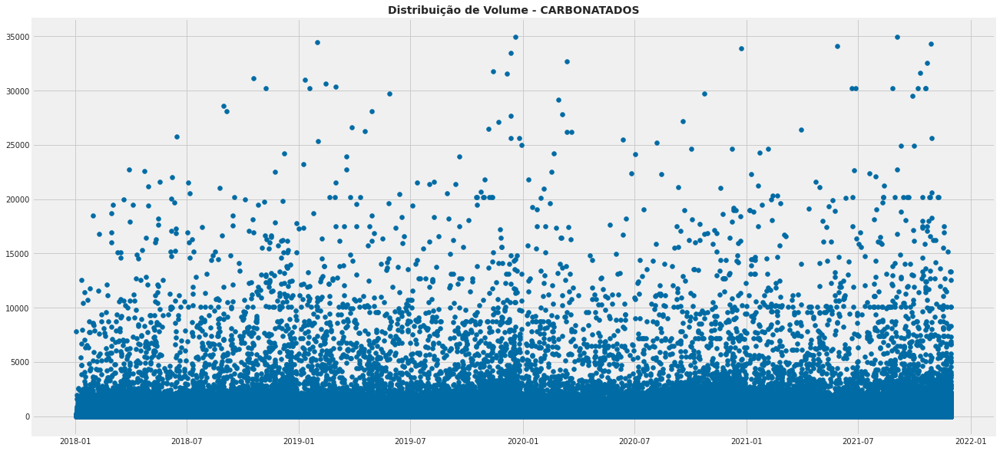

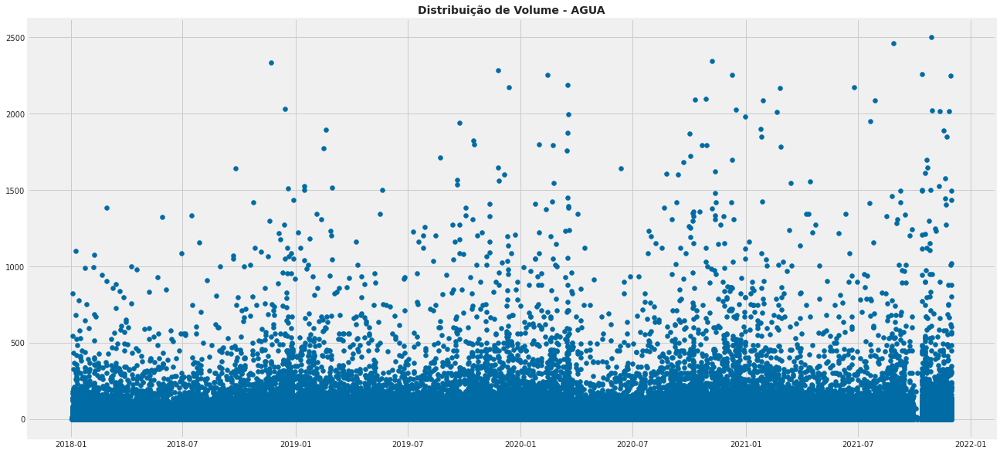

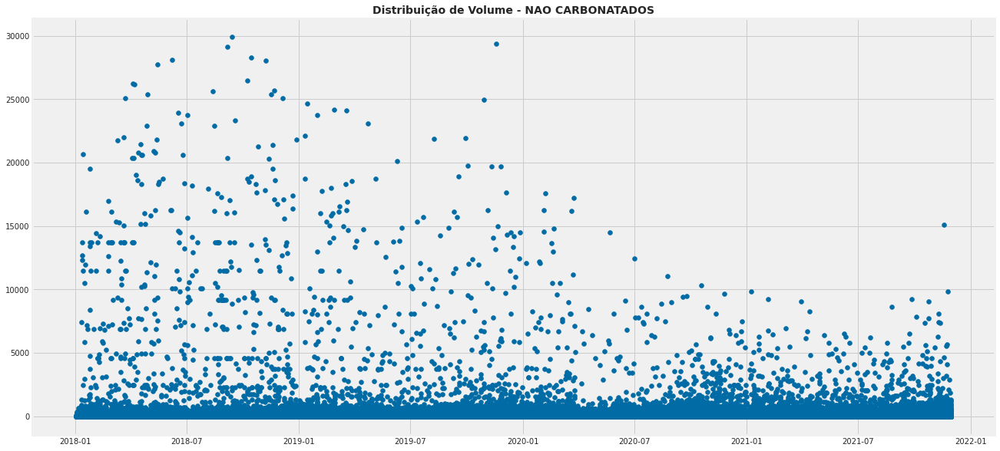

In [15]:
for categoria in df_categoria:
  plt.figure(figsize=(20,10))
  data = df[df.ds_categoria == categoria]
  plt.title('Distribuição de Volume - {}'.format(categoria), size=14, fontweight='bold')
  plt.scatter(data.dt_referencia, data.vl_caixa_fisica)
  plt.show()

## Identificando Tendência e Sazonalidade
  

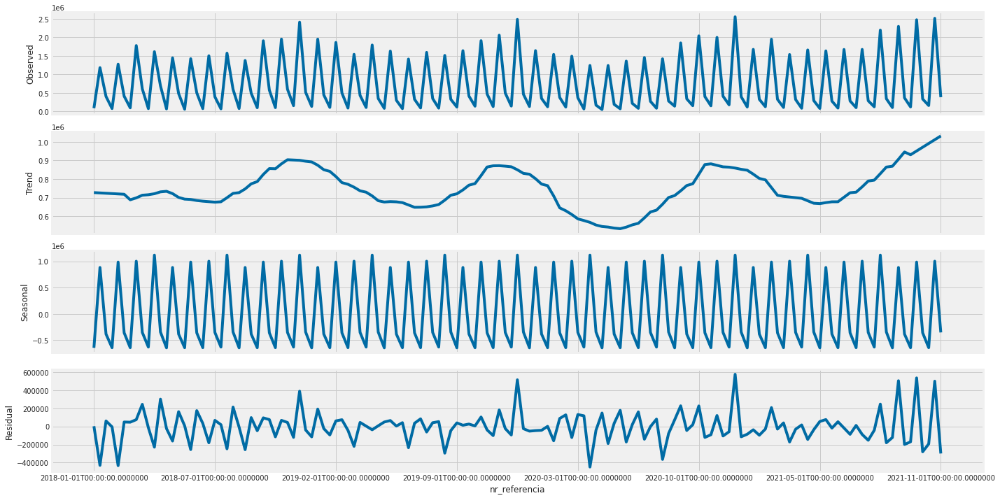

In [16]:
data_month = df.groupby(['nr_referencia', 'ds_categoria'])['vl_caixa_fisica'].sum().to_frame().reset_index().set_index('nr_referencia')

rcParams['figure.figsize'] = 20, 10
decomposition = sm.tsa.seasonal_decompose(data_month.vl_caixa_fisica, model='additive',freq=12, extrapolate_trend = 12)
fig = decomposition.plot()

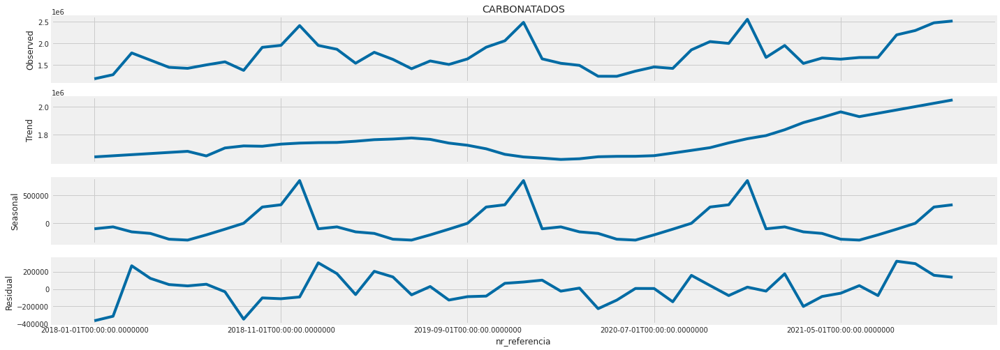

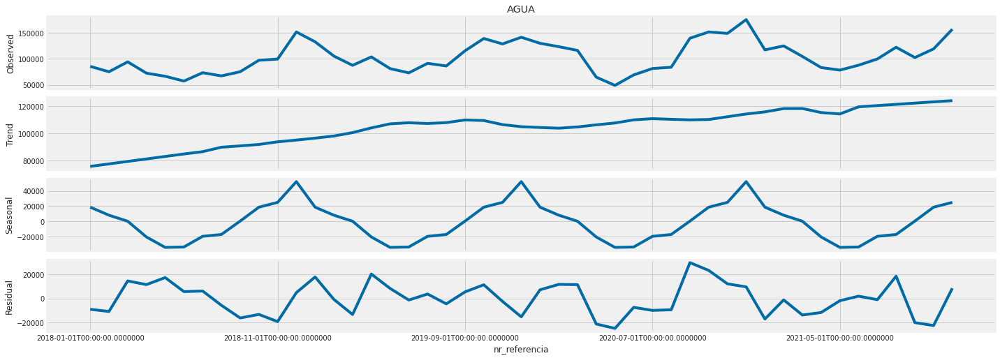

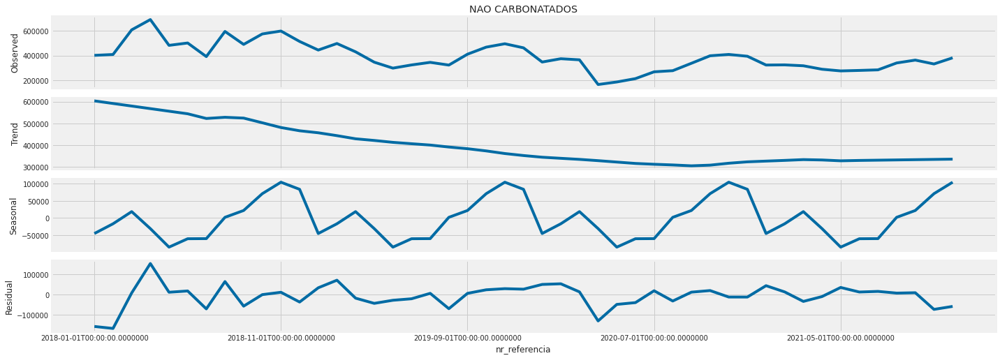

In [17]:
rcParams['figure.figsize'] = 20, 7
for categoria in df_categoria:  
  data = data_month[data_month.ds_categoria == categoria][['vl_caixa_fisica']]
  decomposition = sm.tsa.seasonal_decompose(data, model='additive',freq=12, extrapolate_trend = 12)    
  fig = decomposition.plot()
  axes = fig.get_axes()
  
  axes[0].set_title(categoria)

Observa-se nos gráficos acima que as séries temporais apresentam sazonalidade e tendência crescente para CARBONATADOS e AGUA e tendência decrescente para NAO CARBONATADOS

# Predições

## Avaliação dos modelos

In [18]:
df_metrics = pd.DataFrame(columns=['Model','Categoria','MAE','RMSE'])

In [19]:
def metrics_aval(df_aval, model_name, cat, y_true, y_pred):
  y_true, y_pred = np.array(y_true), np.array(y_pred)
  
  mae  = round(mean_absolute_error(y_true, y_pred),2)
  mse  = mean_squared_error(y_true, y_pred)
  rmse = round(np.sqrt(mse),2)

  df_aval = df_aval.append({'Model':model_name, 'Categoria':cat, 'MAE':mae, 'RMSE':rmse}, ignore_index=True)

  return df_aval

## XGBOOST

### Treino e Teste

In [20]:
def train_test_split(cat, df_base, dt_corte):
  df_cat = df_base.where(df_base.ds_categoria == cat).groupby('dt_referencia')['vl_caixa_fisica'].sum().to_frame().reset_index()

  train = df_cat[df_cat.dt_referencia < dt_corte]
  test = df_cat[df_cat.dt_referencia >= dt_corte]

  return train, test

### Criar recursos de série temporal

In [21]:
def create_features(df, label=None):
  df['date'] = df['dt_referencia']
  df['dayofweek'] = df['dt_referencia'].dt.dayofweek
  df['quarter'] = df['dt_referencia'].dt.quarter
  df['month'] = df['dt_referencia'].dt.month
  df['year'] = df['dt_referencia'].dt.year
  df['dayofyear'] = df['dt_referencia'].dt.dayofyear
  df['dayofmonth'] = df['dt_referencia'].dt.day
  df['weekofyear'] = df['dt_referencia'].dt.weekofyear
  X = df[['dayofweek', 'quarter', 'month', 'year', 'dayofyear', 'dayofmonth', 'weekofyear']]
  
  if label:
    y = df[label]
  
  return X, y  
  return X

In [22]:
def adjust_features(f_train, f_test):
  X_train, y_train = create_features(f_train, label='vl_caixa_fisica')
  X_test, y_test = create_features(f_test, label='vl_caixa_fisica')

  return X_train, y_train, X_test, y_test

### Tuning de hiperparâmetros

In [23]:
def xgboost_gs(X_train, y_train):

  params = {
      'min_child_weight': [4, 5, 6], 
      'gamma': [i / 10.0 for i in range(2, 6)],
      'subsample': [i / 10.0 for i in range(6, 11)],
      'colsample_bytree': [i / 10.0 for i in range(6, 11)],
      'max_depth': [5, 9],
      'eta':[0.3],
      'eval_metric': ['rmse']
  }

  xgb_reg = xgb.XGBRegressor(nthread=-1, objective='reg:squarederror')
  grid = GridSearchCV(xgb_reg, params)
  grid.fit(X_train, y_train)
  gridcv_xgb = grid.best_estimator_
  print(grid.best_estimator_)

  return grid

In [24]:
def predict(model_fit, df_train, df_test, test_X, dt_corte):
  df_test['Prediction'] = model_fit.predict(test_X)
  df_all = pd.concat([df_test, df_train], sort=False)
  df_all.set_index('dt_referencia', inplace=True)
  df_all = df_all[df_all.date >= dt_corte]
  _ = df_all[['vl_caixa_fisica','Prediction']].plot(figsize=(15, 5))

  return df_test

XGBRegressor(colsample_bytree=0.6, eta=0.3, eval_metric='rmse', gamma=0.2,
             max_depth=5, min_child_weight=4, nthread=-1,
             objective='reg:squarederror', subsample=1.0)
XGBRegressor(colsample_bytree=0.6, eta=0.3, eval_metric='rmse', gamma=0.2,
             max_depth=5, min_child_weight=4, nthread=-1,
             objective='reg:squarederror', subsample=0.9)
XGBRegressor(colsample_bytree=0.6, eta=0.3, eval_metric='rmse', gamma=0.2,
             max_depth=5, min_child_weight=6, nthread=-1,
             objective='reg:squarederror', subsample=0.6)


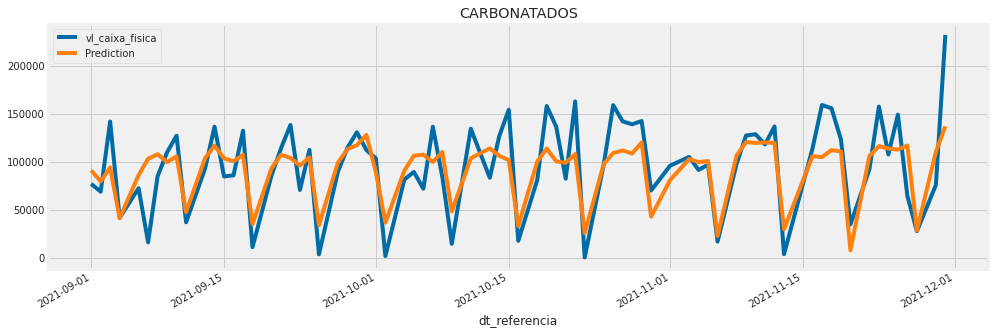

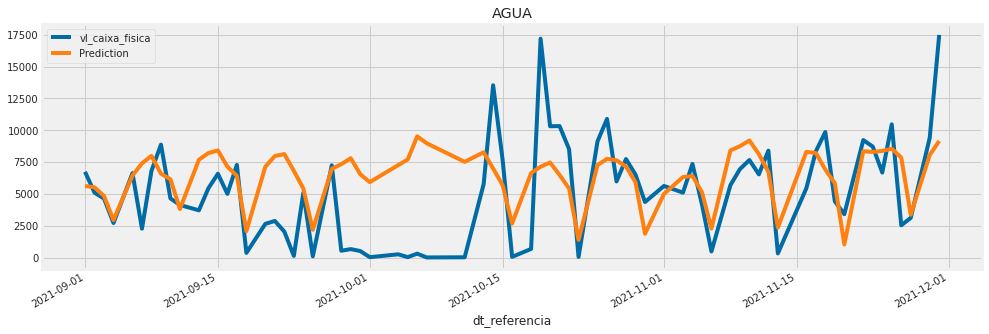

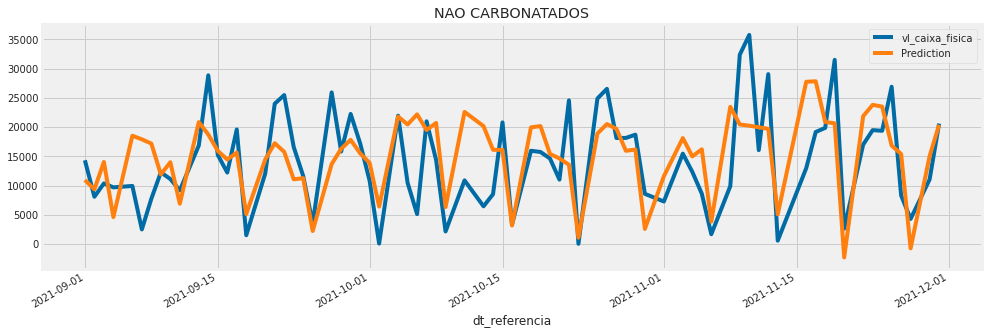

In [25]:
for categoria in df_categoria:   
  #Separa em treino e teste
  train, test = train_test_split(categoria, df, '2021-09-01')

  #Ajusta treino e teste com recursos de série temporal
  X_train, y_train, X_test, y_test = adjust_features(train, test)

  #Ajusta o modelo
  model = xgboost_gs(X_train, y_train)  

  #Predição
  test['Prediction'] = model.predict(X_test)
  df_all = pd.concat([test, train], sort=False)
  df_all.set_index('dt_referencia', inplace=True)
  df_all = df_all[df_all.date >= '2021-09-01']
  _ = df_all[['vl_caixa_fisica','Prediction']].plot(figsize=(15, 5), title=categoria)

  #Avaliação do modelo
  df_metrics = metrics_aval(df_metrics, 'XGBOOST', categoria, y_true=test['vl_caixa_fisica'], y_pred=test['Prediction'])


## PROPHET

O Profeta precisa de um tipo de quadro de dados muito específico para funcionar. 
O que precisamos é:
- Coluna de data como ds.
- Coluna de valor como y.

### Treino e Teste

In [26]:
dt_corte = pd.to_datetime('2021-09-01')
train = df[df.dt_referencia < dt_corte]
test  = df[df.dt_referencia >= dt_corte]

### Modelo básico

In [27]:
def basic_prophet(cat, df_train, df_test, df_metrics):

  df_train = df_train.where(df_train.ds_categoria == cat).groupby('dt_referencia').vl_caixa_fisica.sum().reset_index()
  df_train.columns = ["ds", "y"]

  df_test = df_test.where(df_test.ds_categoria == cat).groupby('dt_referencia').vl_caixa_fisica.sum().reset_index()
  df_test.columns = ["ds", "y"]

  model= Prophet()
  model.fit(df_train)

  forecast = model.predict(df_test)

  #Avaliação do modelo
  df_metrics = metrics_aval(df_metrics, 'BASIC_PROPHET', cat, y_true=df_test.y, y_pred=forecast.yhat)

  return model, df_train, df_test, forecast, df_metrics

In [28]:
#treina e testa por categoria

for categoria in df_categoria:
  model, aj_train, aj_test, forecast, df_metrics = basic_prophet(categoria, train, test, df_metrics)
  forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()  
  
  py.init_notebook_mode()
  fig = plot_plotly(model, forecast)
  fig.update_layout(title=categoria)
  #py.iplot(fig) #run on jupyter notebook
  fig.show(renderer="colab") #run on colab

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


### Ajuste de Parametros e Cross Validation

In [29]:
def performance_cv(model, initial, days):
   df_cv = cross_validation(model, initial=f'{initial} days', period=f'{days} days', horizon =f'{days} days')

   return df_cv

In [30]:
def param_prophet(cat, df_train, df_test):

  df_train = df_train.where(df_train.ds_categoria == cat).groupby('dt_referencia').vl_caixa_fisica.sum().reset_index()
  df_train.columns = ["ds", "y"]

  df_test = df_test.where(df_test.ds_categoria == cat).groupby('dt_referencia').vl_caixa_fisica.sum().reset_index()
  df_test.columns = ["ds", "y"]

  initial_days = len(df_test)
  period_days = len(df_test)

  model =  Prophet(
      seasonality_mode="multiplicative",
      yearly_seasonality=True,
      weekly_seasonality=False,
      daily_seasonality=False,
  )

  model.fit(df_train)

  forecast = model.predict(df_test)

  return model, forecast, initial_days, period_days

In [31]:
for categoria in df_categoria:

  model, forecast, initial, prev_days = param_prophet(categoria, train, test)

  df_cv = performance_cv(model, initial, prev_days)

  df_p = performance_metrics(df_cv)
  df_p = df_p.mean().to_frame()

  mae = round(df_p[df_p.index == 'mae'][0][0],2)
  mse = round(df_p[df_p.index == 'mse'][0][0],2)
  rmse = round(df_p[df_p.index == 'rmse'][0][0],2)

  # Avaliação do Modelo
  df_metrics = df_metrics.append({'Model': 'MANUAL_PROPHET', 'Categoria':categoria, 'MAE':mae, 'RMSE':rmse}, ignore_index=True)

INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-25 00:00:00 and 2021-06-20 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

### Tuning de hiperparâmetros

In [32]:
grid_param = {  
    'seasonality_prior_scale': [0.01, 0.1, 1.0, 10.0],
    'seasonality_mode': ['multiplicative', 'additive'],
    'yearly_seasonality' : [True, False]
}

In [33]:
all_params = [dict(zip(grid_param.keys(), v)) for v in itertools.product(*grid_param.values())]
rmses = []

In [34]:
df_best = pd.DataFrame(columns= ['ds_categoria','params'])

for categoria in df_categoria: 

  rmses.clear() 

  for params in all_params:
      
    df_train = train.where(train.ds_categoria == categoria).groupby('dt_referencia').vl_caixa_fisica.sum().reset_index()
    df_train.columns = ["ds", "y"]

    df_test = test.where(test.ds_categoria == categoria).groupby('dt_referencia').vl_caixa_fisica.sum().reset_index()
    df_test.columns = ["ds", "y"]

    prev_days = len(df_test)
    initial = len(df_test)

    model = Prophet(**params).fit(df_train)

    df_cv = performance_cv(model, initial, prev_days)

    df_p = performance_metrics(df_cv, rolling_window=1)
    rmses.append(df_p['rmse'].values[0])

  tuning_results = pd.DataFrame(all_params)
  print('index', categoria, np.argmin(rmses))
  best_params = all_params[np.argmin(rmses)]

  df_best = df_best.append({'ds_categoria':categoria, 'params':best_params}, ignore_index = True)
  print(categoria,  best_params)

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


index CARBONATADOS 10
CARBONATADOS {'seasonality_prior_scale': 1.0, 'seasonality_mode': 'additive', 'yearly_seasonality': True}


INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-25 00:00:00 and 2021-06-20 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-25 00:00:00 and 2021-06-20 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-25 00:00:00 and 2021-06-20 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-25 00:00:00 and 2021-06-20 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-25 00:00:00 and 2021-06-20 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-25 00:00:00 and 2021-06-20 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-25 00:00:00 and 2021-06-20 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-25 00:00:00 and 2021-06-20 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-25 00:00:00 and 2021-06-20 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-25 00:00:00 and 2021-06-20 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-25 00:00:00 and 2021-06-20 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-25 00:00:00 and 2021-06-20 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-25 00:00:00 and 2021-06-20 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-25 00:00:00 and 2021-06-20 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-25 00:00:00 and 2021-06-20 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-25 00:00:00 and 2021-06-20 00:00:00


  0%|          | 0/17 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


index AGUA 4
AGUA {'seasonality_prior_scale': 0.1, 'seasonality_mode': 'multiplicative', 'yearly_seasonality': True}


INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

index NAO CARBONATADOS 2
NAO CARBONATADOS {'seasonality_prior_scale': 0.01, 'seasonality_mode': 'additive', 'yearly_seasonality': True}


In [35]:
def tunning_prophet(cat, df_train, df_test, df_best_param, df_metrics):

  df_train = df_train.where(df_train.ds_categoria == cat).groupby('dt_referencia').vl_caixa_fisica.sum().reset_index()
  df_train.columns = ["ds", "y"]
  
  df_test = df_test.where(df_test.ds_categoria == cat).groupby('dt_referencia').vl_caixa_fisica.sum().reset_index()
  df_test.columns = ["ds", "y"]

  # Busca best params para categoria informada
  params = df_best_param[df_best_param.index == cat]['params'][0]
  r = "{}'"
  pattern = "[" + r + "]"
  params = re.sub(pattern, "", str(df_best[df_best.index == cat].params[0])).replace(':',"=").replace('multiplicative',"'multiplicative'").replace('additive',"'additive'")

  str_exec = "Prophet("+params+")"
  model = eval(str_exec)

  model.fit(df_train)

  forecast = model.predict(df_test)

  #Avaliação do modelo
  df_metrics = metrics_aval(df_metrics, 'TUNING_PROPHET', cat, y_true=df_test.y, y_pred=forecast.yhat)

  return model, forecast, df_metrics

In [36]:
from fbprophet.diagnostics import performance_metrics
from fbprophet.diagnostics import cross_validation


#Seta categoria como index do Data Frame
df_best = df_best.set_index('ds_categoria')

#treina e testa por categoria o modelo 'tunado'
for categoria in df_categoria:
  
  model_prophet, forecast, df_metrics = tunning_prophet(categoria, train, test, df_best, df_metrics)

  df_cv = performance_cv(model_prophet, initial, prev_days)
  df_p = performance_metrics(df_cv)

  print(categoria, "\n",df_p.mean().to_frame())

  py.init_notebook_mode()
  fig = plot_plotly(model, forecast)
  fig.update_layout(title=categoria)
  #py.iplot(fig) #run on jupyter notebook
  fig.show(renderer="colab") #run on colab
  

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

CARBONATADOS 
                          0
horizon   41 days 12:00:00
mse            8.42476e+08
rmse               28967.4
mae                21961.3
mape                9.3536
mdape             0.249144
coverage          0.751885


INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

AGUA 
                          0
horizon   41 days 12:00:00
mse            5.30273e+06
rmse                2263.9
mae                1721.39
mape                12.932
mdape             0.380274
coverage          0.651897


INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 16 forecasts with cutoffs between 2018-05-19 00:00:00 and 2021-06-17 00:00:00


  0%|          | 0/16 [00:00<?, ?it/s]

NAO CARBONATADOS 
                          0
horizon   41 days 12:00:00
mse            1.19299e+08
rmse               10901.7
mae                8051.28
mape               75.9938
mdape             0.410597
coverage          0.865882


## NEURAL PROPHET

### Modelo básico

In [37]:
def basic_neural_prophet(cat, df_train, df_test, df_metrics):

  df_train = df_train.where(df_train.ds_categoria == cat).groupby('dt_referencia').vl_caixa_fisica.sum().reset_index()
  df_train.columns = ["ds", "y"]
  
  df_test = df_test.where(df_test.ds_categoria == cat).groupby('dt_referencia').vl_caixa_fisica.sum().reset_index()
  df_test.columns = ["ds", "y"]

  model = NeuralProphet()

  periods  = len(df_test)
  metrics  = model.fit(df_train, freq="D", epochs=1)
  future   = model.make_future_dataframe( df_train, periods=periods, n_historic_predictions=True)
  forecast = model.predict(future)
 
  #Avaliação do modelo
  df_concat = pd.concat([df_train, df_test]).reset_index()
  df_metrics = metrics_aval(df_metrics, 'BASIC_NEURAL_PROPHET', cat, y_true=df_concat.y, y_pred=forecast.yhat1)

  return model, forecast, df_metrics

INFO - (NP.utils.set_auto_seasonalities) - Disabling daily seasonality. Run NeuralProphet with daily_seasonality=True to override this.
INFO:NP.utils:Disabling daily seasonality. Run NeuralProphet with daily_seasonality=True to override this.
INFO - (NP.config.set_auto_batch_epoch) - Auto-set batch_size to 32
INFO:NP.config:Auto-set batch_size to 32


  0%|          | 0/252 [00:00<?, ?it/s]

INFO - (NP.utils_torch.lr_range_test) - lr-range-test results: steep: 5.46E-02, min: 1.37E+00
INFO:NP.utils_torch:lr-range-test results: steep: 5.46E-02, min: 1.37E+00


  0%|          | 0/252 [00:00<?, ?it/s]

INFO - (NP.utils_torch.lr_range_test) - lr-range-test results: steep: 5.03E-02, min: 1.90E+00
INFO:NP.utils_torch:lr-range-test results: steep: 5.03E-02, min: 1.90E+00


  0%|          | 0/252 [00:00<?, ?it/s]

INFO - (NP.utils_torch.lr_range_test) - lr-range-test results: steep: 5.46E-02, min: 9.82E-01
INFO:NP.utils_torch:lr-range-test results: steep: 5.46E-02, min: 9.82E-01
INFO - (NP.forecaster._init_train_loader) - lr-range-test selected learning rate: 5.31E-02
INFO:NP.forecaster:lr-range-test selected learning rate: 5.31E-02
Epoch[1/1]: 100%|██████████| 1/1 [00:00<00:00, 10.82it/s, SmoothL1Loss=0.484, MAE=1.01e+5, RMSE=1.26e+5, RegLoss=0]
INFO - (NP.utils.set_auto_seasonalities) - Disabling daily seasonality. Run NeuralProphet with daily_seasonality=True to override this.
INFO:NP.utils:Disabling daily seasonality. Run NeuralProphet with daily_seasonality=True to override this.
INFO - (NP.config.set_auto_batch_epoch) - Auto-set batch_size to 32
INFO:NP.config:Auto-set batch_size to 32


  0%|          | 0/252 [00:00<?, ?it/s]

INFO - (NP.utils_torch.lr_range_test) - lr-range-test results: steep: 2.39E-02, min: 9.82E-01
INFO:NP.utils_torch:lr-range-test results: steep: 2.39E-02, min: 9.82E-01


  0%|          | 0/252 [00:00<?, ?it/s]

INFO - (NP.utils_torch.lr_range_test) - lr-range-test results: steep: 1.73E-01, min: 1.61E+00
INFO:NP.utils_torch:lr-range-test results: steep: 1.73E-01, min: 1.61E+00


  0%|          | 0/252 [00:00<?, ?it/s]

INFO - (NP.utils_torch.lr_range_test) - lr-range-test results: steep: 1.88E-01, min: 1.90E+00
INFO:NP.utils_torch:lr-range-test results: steep: 1.88E-01, min: 1.90E+00
INFO - (NP.forecaster._init_train_loader) - lr-range-test selected learning rate: 9.21E-02
INFO:NP.forecaster:lr-range-test selected learning rate: 9.21E-02
Epoch[1/1]: 100%|██████████| 1/1 [00:00<00:00, 11.80it/s, SmoothL1Loss=0.247, MAE=4.58e+3, RMSE=5.55e+3, RegLoss=0]
INFO - (NP.utils.set_auto_seasonalities) - Disabling daily seasonality. Run NeuralProphet with daily_seasonality=True to override this.
INFO:NP.utils:Disabling daily seasonality. Run NeuralProphet with daily_seasonality=True to override this.
INFO - (NP.config.set_auto_batch_epoch) - Auto-set batch_size to 32
INFO:NP.config:Auto-set batch_size to 32


  0%|          | 0/252 [00:00<?, ?it/s]

INFO - (NP.utils_torch.lr_range_test) - lr-range-test results: steep: 4.26E-02, min: 1.37E+00
INFO:NP.utils_torch:lr-range-test results: steep: 4.26E-02, min: 1.37E+00


  0%|          | 0/252 [00:00<?, ?it/s]

INFO - (NP.utils_torch.lr_range_test) - lr-range-test results: steep: 4.26E-02, min: 1.26E+00
INFO:NP.utils_torch:lr-range-test results: steep: 4.26E-02, min: 1.26E+00


  0%|          | 0/252 [00:00<?, ?it/s]

INFO - (NP.utils_torch.lr_range_test) - lr-range-test results: steep: 4.26E-02, min: 1.07E+00
INFO:NP.utils_torch:lr-range-test results: steep: 4.26E-02, min: 1.07E+00
INFO - (NP.forecaster._init_train_loader) - lr-range-test selected learning rate: 4.26E-02
INFO:NP.forecaster:lr-range-test selected learning rate: 4.26E-02
Epoch[1/1]: 100%|██████████| 1/1 [00:00<00:00,  9.22it/s, SmoothL1Loss=0.343, MAE=2.53e+4, RMSE=3.12e+4, RegLoss=0]


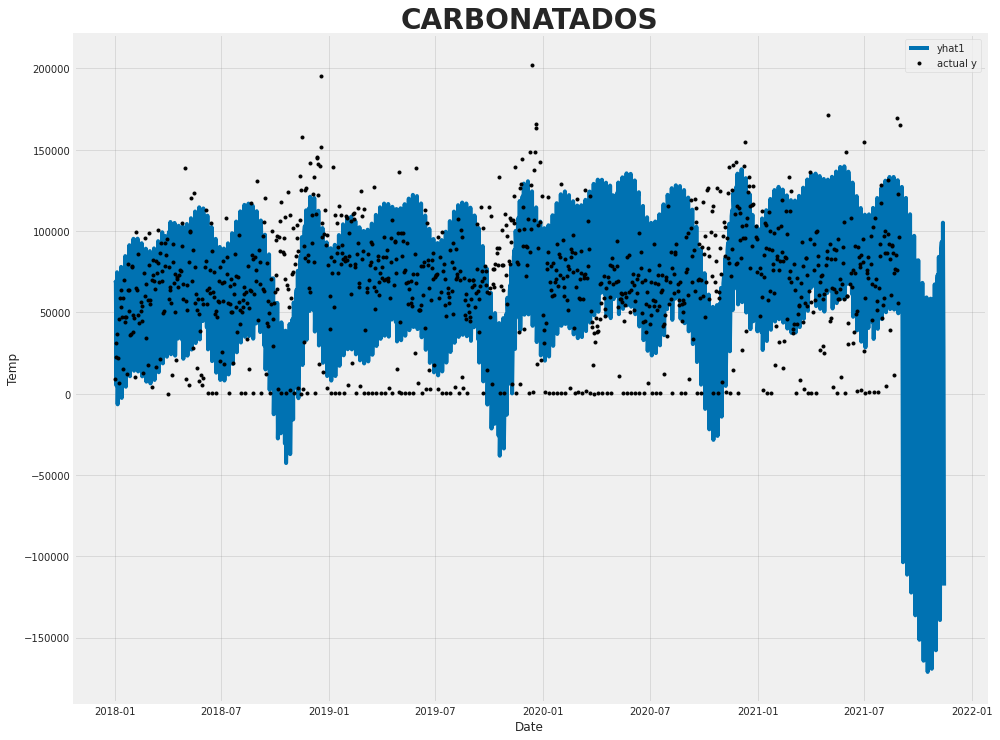

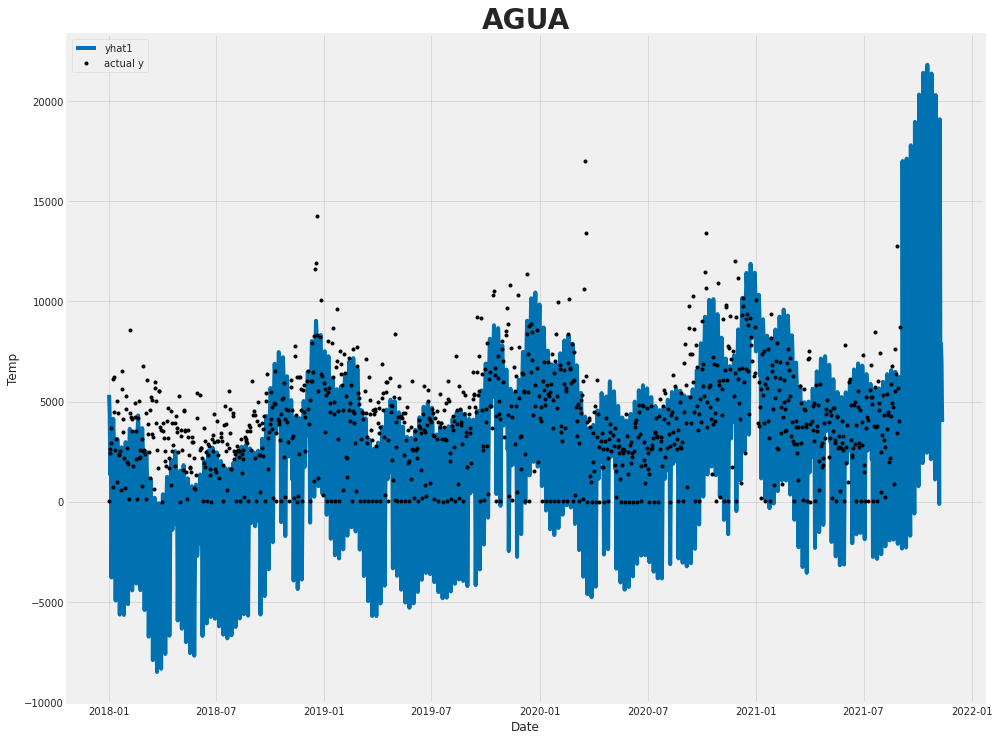

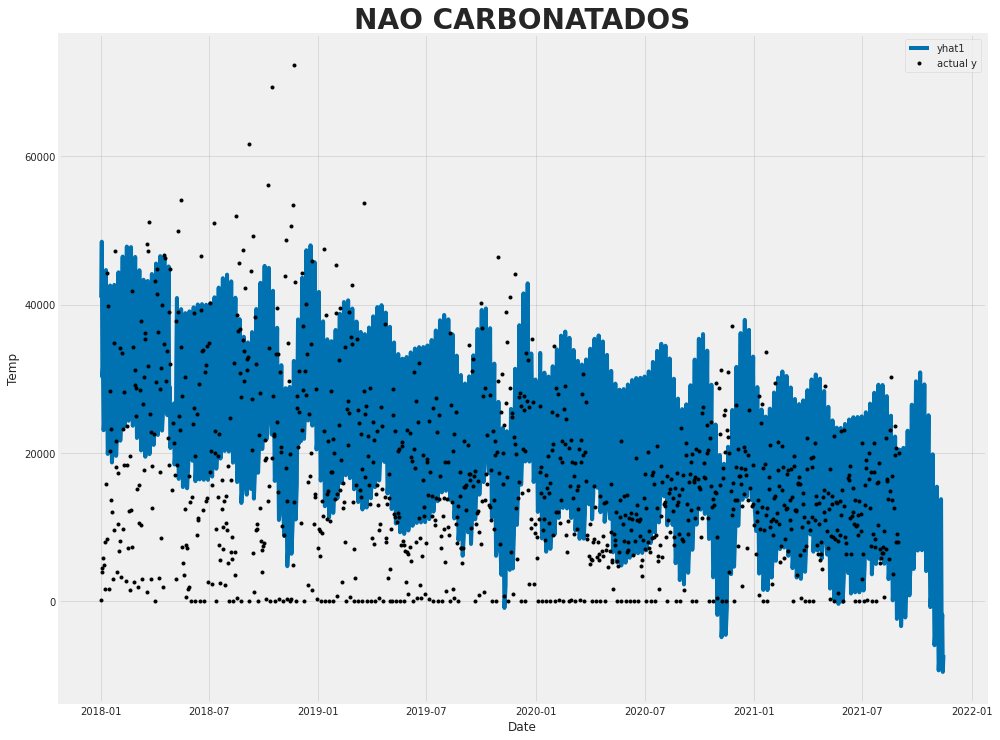

In [38]:
for categoria in df_categoria:
  
  model, forecast, df_metrics = basic_neural_prophet(categoria, train, test, df_metrics)

  fig, ax = plt.subplots(figsize=(14, 10))
  model.plot(forecast, xlabel="Date", ylabel="Temp", ax=ax)
  ax.set_title(categoria, fontsize=28, fontweight="bold")

### Tuning de hiperparâmetros

In [39]:
def tuning_neural_prophet(cat, df_train, df_test, df_metrics):

  df_train = df_train.where(df_train.ds_categoria == cat).groupby('dt_referencia').vl_caixa_fisica.sum().reset_index()
  df_train.columns = ["ds", "y"]
  
  df_test = df_test.where(df_test.ds_categoria == cat).groupby('dt_referencia').vl_caixa_fisica.sum().reset_index()
  df_test.columns = ["ds", "y"]

  model = NeuralProphet(
    n_changepoints=10,
    trend_reg=2, 
    yearly_seasonality=True,
    weekly_seasonality=True,
    daily_seasonality=False
  )

  initial_days = len(df_test)
  period_days = len(df_test)

  periods = len(df_test)
  metrics = model.fit(df_train, freq="D", epochs=1000)
  future = model.make_future_dataframe(df_train, periods=periods, n_historic_predictions=True)
  forecast = model.predict(future)

  #Avaliação do modelo
  df_concat = pd.concat([df_train, df_test]).reset_index()
  df_metrics = metrics_aval(df_metrics, 'TUNNING_NEURAL_PROPHET', cat, y_true=df_concat.y, y_pred=forecast.yhat1)

  return model, forecast, df_metrics, initial_days, period_days

INFO - (NP.config.__post_init__) - Note: Trend changepoint regularization is experimental.
INFO:NP.config:Note: Trend changepoint regularization is experimental.
INFO - (NP.config.set_auto_batch_epoch) - Auto-set batch_size to 32
INFO:NP.config:Auto-set batch_size to 32


  0%|          | 0/252 [00:00<?, ?it/s]

INFO - (NP.utils_torch.lr_range_test) - lr-range-test results: steep: 1.25E-01, min: 2.06E+00
INFO:NP.utils_torch:lr-range-test results: steep: 1.25E-01, min: 2.06E+00


  0%|          | 0/252 [00:00<?, ?it/s]

INFO - (NP.utils_torch.lr_range_test) - lr-range-test results: steep: 1.25E-01, min: 1.48E+00
INFO:NP.utils_torch:lr-range-test results: steep: 1.25E-01, min: 1.48E+00


  0%|          | 0/252 [00:00<?, ?it/s]

INFO - (NP.utils_torch.lr_range_test) - lr-range-test results: steep: 1.25E-01, min: 3.96E-01
INFO:NP.utils_torch:lr-range-test results: steep: 1.25E-01, min: 3.96E-01
INFO - (NP.forecaster._init_train_loader) - lr-range-test selected learning rate: 1.25E-01
INFO:NP.forecaster:lr-range-test selected learning rate: 1.25E-01
Epoch[1000/1000]: 100%|██████████| 1000/1000 [01:24<00:00, 11.87it/s, SmoothL1Loss=0.0196, MAE=1.81e+4, RMSE=2.43e+4, RegLoss=0.00143]
INFO - (NP.config.__post_init__) - Note: Trend changepoint regularization is experimental.
INFO:NP.config:Note: Trend changepoint regularization is experimental.
INFO - (NP.config.set_auto_batch_epoch) - Auto-set batch_size to 32
INFO:NP.config:Auto-set batch_size to 32


  0%|          | 0/252 [00:00<?, ?it/s]

INFO - (NP.utils_torch.lr_range_test) - lr-range-test results: steep: 1.06E-01, min: 1.37E+00
INFO:NP.utils_torch:lr-range-test results: steep: 1.06E-01, min: 1.37E+00


  0%|          | 0/252 [00:00<?, ?it/s]

INFO - (NP.utils_torch.lr_range_test) - lr-range-test results: steep: 8.96E-02, min: 1.26E+00
INFO:NP.utils_torch:lr-range-test results: steep: 8.96E-02, min: 1.26E+00


  0%|          | 0/252 [00:00<?, ?it/s]

INFO - (NP.utils_torch.lr_range_test) - lr-range-test results: steep: 9.73E-02, min: 1.48E+00
INFO:NP.utils_torch:lr-range-test results: steep: 9.73E-02, min: 1.48E+00
INFO - (NP.forecaster._init_train_loader) - lr-range-test selected learning rate: 9.73E-02
INFO:NP.forecaster:lr-range-test selected learning rate: 9.73E-02
Epoch[1000/1000]: 100%|██████████| 1000/1000 [01:24<00:00, 11.83it/s, SmoothL1Loss=0.021, MAE=1.26e+3, RMSE=1.69e+3, RegLoss=0.00873]
INFO - (NP.config.__post_init__) - Note: Trend changepoint regularization is experimental.
INFO:NP.config:Note: Trend changepoint regularization is experimental.
INFO - (NP.config.set_auto_batch_epoch) - Auto-set batch_size to 32
INFO:NP.config:Auto-set batch_size to 32


  0%|          | 0/252 [00:00<?, ?it/s]

INFO - (NP.utils_torch.lr_range_test) - lr-range-test results: steep: 7.59E-02, min: 5.07E-01
INFO:NP.utils_torch:lr-range-test results: steep: 7.59E-02, min: 5.07E-01


  0%|          | 0/252 [00:00<?, ?it/s]

INFO - (NP.utils_torch.lr_range_test) - lr-range-test results: steep: 6.99E-02, min: 5.98E-01
INFO:NP.utils_torch:lr-range-test results: steep: 6.99E-02, min: 5.98E-01


  0%|          | 0/252 [00:00<?, ?it/s]

INFO - (NP.utils_torch.lr_range_test) - lr-range-test results: steep: 1.23E-02, min: 8.32E-01
INFO:NP.utils_torch:lr-range-test results: steep: 1.23E-02, min: 8.32E-01
INFO - (NP.forecaster._init_train_loader) - lr-range-test selected learning rate: 4.03E-02
INFO:NP.forecaster:lr-range-test selected learning rate: 4.03E-02
Epoch[1000/1000]: 100%|██████████| 1000/1000 [01:24<00:00, 11.89it/s, SmoothL1Loss=0.0305, MAE=7e+3, RMSE=9.38e+3, RegLoss=0.0216]


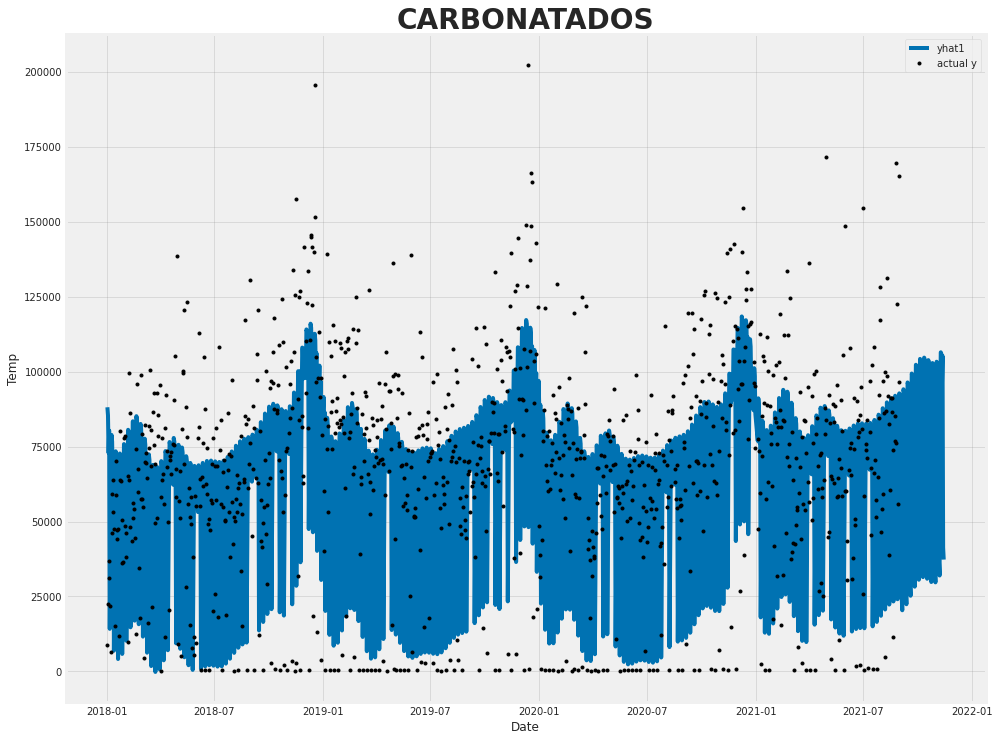

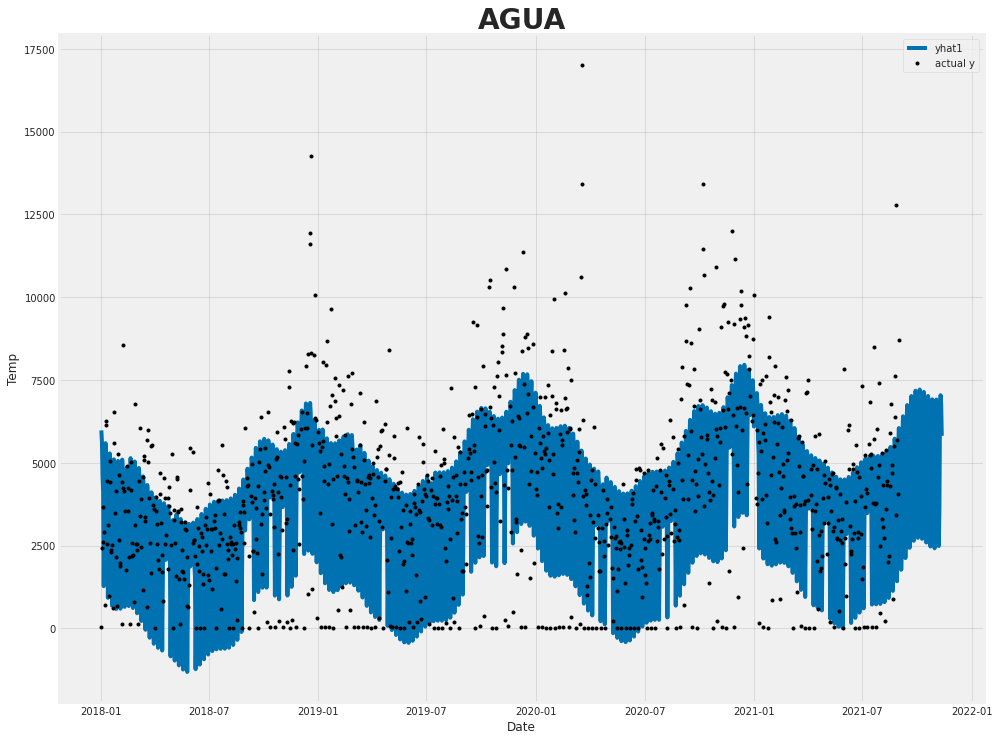

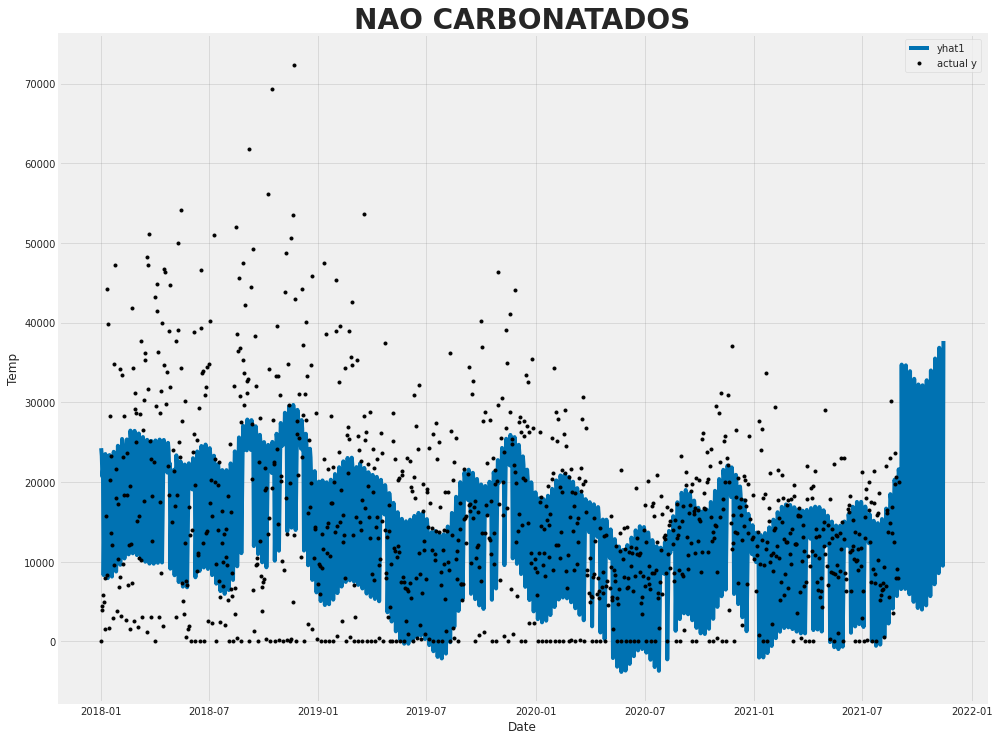

In [40]:
for categoria in df_categoria:
  
  model, forecast, df_metrics, initial, prev_days = tuning_neural_prophet(categoria, train, test, df_metrics)

  fig, ax = plt.subplots(figsize=(14, 10))
  model.plot(forecast, xlabel="Date", ylabel="Temp", ax=ax)
  ax.set_title(categoria, fontsize=28, fontweight="bold")

_________

#Resultados

In [41]:
df_metrics

,Model,Categoria,MAE,RMSE
0,XGBOOST,CARBONATADOS,23315.95,29531.35
1,XGBOOST,AGUA,2987.80,3939.91
2,XGBOOST,NAO CARBONATADOS,5540.23,6967.20
3,BASIC_PROPHET,CARBONATADOS,26762.02,34174.90
4,BASIC_PROPHET,AGUA,2853.09,3725.63
5,BASIC_PROPHET,NAO CARBONATADOS,5617.57,6791.90
6,MANUAL_PROPHET,CARBONATADOS,29720.77,39274.46
7,MANUAL_PROPHET,AGUA,5041.48,14101.51
8,MANUAL_PROPHET,NAO CARBONATADOS,9779.85,12896.66
9,TUNING_PROPHET,CARBONATADOS,26969.08,34534.22
